<a href="https://colab.research.google.com/github/pchernic/python_for_financial_data/blob/main/Stock_Market_Data_and_Animated_plots.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Stock Market Data and Animated Plots.

In [1]:
from pandas_datareader import data as pdr
from datetime import datetime
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

### MatPlotlib themes

In order to enhance plot visuals, we can explore matplotlib themes.


In [3]:
!pip install -q mplcyberpunk
import mplcyberpunk
import matplotlib.ticker as mtick

plt.style.use("cyberpunk")

### S&P 500

Weekly Resample

[*********************100%%**********************]  1 of 1 completed


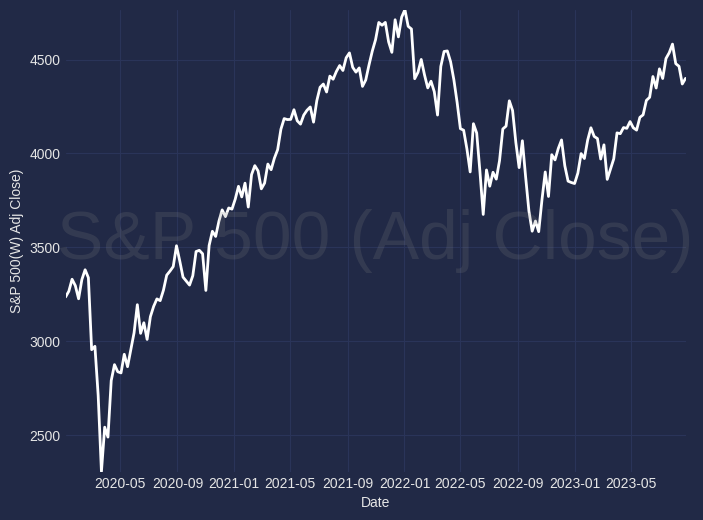

In [4]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from datetime import datetime, timedelta
import yfinance as yf
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML


# Obtain yesterday's date
yesterday = datetime.today() - timedelta(days=1)

# Obtain S&P 500 data
sp500 = yf.download('^GSPC', start='2020-01-01', end=yesterday)

# Resample the DataFrame to a weekly interval and forward-fill missing values
sp500_weekly = sp500.resample('W').last().ffill()

# Reset the index and create a new 'Date' column
sp500_weekly = sp500_weekly.reset_index()
sp500_weekly['Date'] = sp500_weekly['Date']

# Sort the DataFrame by the 'Date' column in ascending order
sp500_sorted = sp500_weekly.sort_values('Date')


# Set up the figure and axes
fig, ax = plt.subplots(figsize=(8, 6))

# Initialize an empty line plot
line, = ax.plot([], [], lw=2, color='white')  # Use a white color for the series line

# Set the x and y limits for the plot
ax.set_xlim(sp500_sorted['Date'].min(), sp500_sorted['Date'].max())
ax.set_ylim(sp500_sorted['Adj Close'].min(), sp500_sorted['Adj Close'].max())

# Set the x-axis label
ax.set_xlabel('Date')

# Set the y-axis label
ax.set_ylabel('S&P 500(W) Adj Close)')

# Set the background color and opacity for the title watermark
ax.text(0.5, 0.5, 'S&P 500 (Adj Close)', color='gray', fontsize=50, alpha=0.2,
        ha='center', va='center', transform=ax.transAxes)

# Define the update function for the animation
def update(frame):
    # Get the data up to the current frame
    data = sp500_sorted.iloc[:frame + 1]

    # Update the line plot with the new data
    line.set_data(data['Date'], data['Adj Close'])

    return line,

# Create the animation
ani = animation.FuncAnimation(fig, update, frames=len(sp500_sorted) * 2, interval=30, blit=True)

# Convert the animation to HTML
html_ani = ani.to_jshtml()

# Display the animated chart
HTML(html_ani)


#### Code Breakdown

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from datetime import datetime, timedelta
import yfinance as yf
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

In [ ]:

# Obtain yesterday's date
yesterday = datetime.today() - timedelta(days=1)

# Obtain S&P 500 data
sp500 = yf.download('^GSPC', start='2010-01-01', end=yesterday)


# Resample the DataFrame to a daily interval and forward-fill missing values
sp500_d = sp500.resample('D').last().ffill()

# Resample the DataFrame to a weekly interval and forward-fill missing values
sp500_weekly = sp500.resample('W').last().ffill()

# Resample the DataFrame to a Monthly interval and forward-fill missing values
sp500_m = sp500.resample('M').last().ffill()

# Resample the DataFrame to a Yearly interval and forward-fill missing values
sp500_y = sp500.resample('Y').last().ffill()



[*********************100%***********************]  1 of 1 completed


Yearly example

In [ ]:
# Reset the index and create a new 'Date' column
sp500_y = sp500_y.reset_index()
sp500_y['Date'] = sp500_y['Date']

# Sort the DataFrame by the 'Date' column in ascending order
sp500_sorted = sp500_y.sort_values('Date')

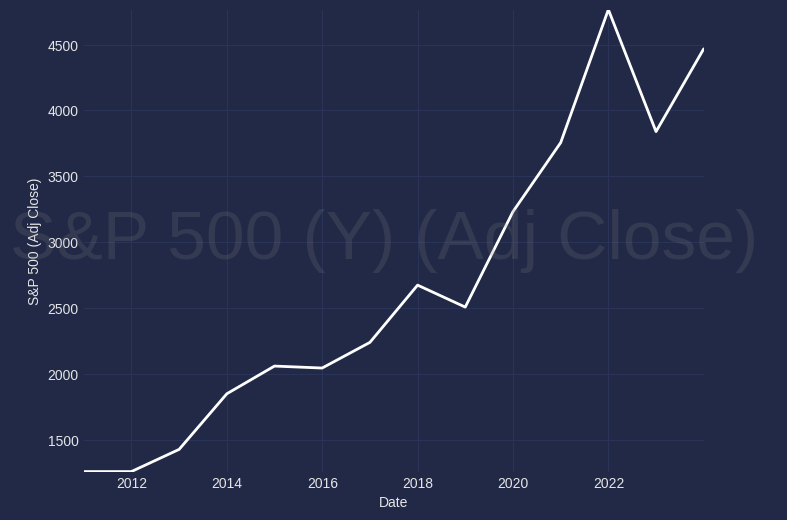

In [ ]:
# Set up the figure and axes
fig, ax = plt.subplots(figsize=(8, 6))

# Initialize an empty line plot
line, = ax.plot([], [], lw=2, color='white')  # Use a white color for the series line

# Set the x and y limits for the plot
ax.set_xlim(sp500_sorted['Date'].min(), sp500_sorted['Date'].max())
ax.set_ylim(sp500_sorted['Adj Close'].min(), sp500_sorted['Adj Close'].max())

# Set the x-axis label
ax.set_xlabel('Date')

# Set the y-axis label
ax.set_ylabel(f'S&P 500 (Adj Close)')

# Set the background color and opacity for the title watermark
ax.text(0.5, 0.5, 'S&P 500 (Y) (Adj Close) ', color='gray', fontsize=50, alpha=0.2,
        ha='center', va='center', transform=ax.transAxes)

# Define the update function for the animation
def update(frame):
    # Get the data up to the current frame
    data = sp500_sorted.iloc[:frame + 1]

    # Update the line plot with the new data
    line.set_data(data['Date'], data['Adj Close'])

    return line,

# Create the animation
ani = animation.FuncAnimation(fig, update, frames=len(sp500_sorted) * 2, interval=100, blit=True)

# Convert the animation to HTML
html_ani = ani.to_jshtml()

# Display the animated chart
HTML(html_ani)


## Stocks

## AAPL
    Exploring candlestick charts.

In [5]:
pip install plotly

In [6]:
pip install mplfinance


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.0/75.0 kB 1.4 MB/s eta 0:00:00


In [7]:
stock = 'AAPL'

# Obtain yesterday's date
yesterday = datetime.today() - timedelta(days=1)

aapl = yf.download(stock, start='2020-01-01', end=yesterday)

# Reset the index to convert the dates into a separate "DATE" column
aapl.reset_index(inplace=True)
aapl.head()

[*********************100%%**********************]  1 of 1 completed


,Date,Open,High,Low,Close,Adj Close,Volume
0,2020-01-02,74.059998,75.150002,73.797501,75.087502,73.249008,135480400
1,2020-01-03,74.287498,75.144997,74.125000,74.357498,72.536911,146322800
2,2020-01-06,73.447502,74.989998,73.187500,74.949997,73.114899,118387200
3,2020-01-07,74.959999,75.224998,74.370003,74.597504,72.771027,108872000
4,2020-01-08,74.290001,76.110001,74.290001,75.797501,73.941650,132079200


#### Candlestick Chart sample

In [8]:
import plotly.graph_objects as go
fig = go.Figure(data=[go.Candlestick(x=aapl['Date'],
                open=aapl['Open'],
                high=aapl['High'],
                low=aapl['Low'],
                close=aapl['Close'])])

fig.show()

#### Animated Monthly Chart
    darkbackground
    watermark

This code creates a downloadable html file with animated chart.

In [9]:
import plotly.graph_objects as go
import plotly.io as pio
from plotly.subplots import make_subplots

# Resample the data to monthly frequency
aapl_monthly = aapl.resample('M', on='Date').agg({'Open': 'first', 'High': 'max', 'Low': 'min', 'Close': 'last', 'Volume': 'sum'})

# Create subplots with two rows (one for the candlestick chart and one for volume)
fig = make_subplots(rows=2, shared_xaxes=True, row_heights=[0.7, 0.3])

# Add candlestick trace to the first subplot
fig.add_trace(
    go.Candlestick(
        x=aapl_monthly.index,
        open=aapl_monthly['Open'],
        high=aapl_monthly['High'],
        low=aapl_monthly['Low'],
        close=aapl_monthly['Close'],
        name='AAPL'
    ),
    row=1, col=1
)

# Add volume trace to the second subplot
fig.add_trace(
    go.Bar(
        x=aapl_monthly.index,
        y=aapl_monthly['Volume'],
        name='Volume'
    ),
    row=2, col=1
)

# Configure the layout
fig.update_layout(
    title='AAPL Monthly Animated Candlestick Chart',
    xaxis_rangeslider_visible=False,
    plot_bgcolor='black',
    paper_bgcolor='black',
    font=dict(color='gray'),
    xaxis=dict(gridcolor='rgba(255, 255, 255, 0.1)'),
    yaxis=dict(gridcolor='rgba(255, 255, 255, 0.1)')
)

# Add watermark annotation
fig.add_annotation(
    xref='paper',
    yref='paper',
    x=0.5,
    y=0.5,
    text='AAPL',
    showarrow=False,
    font=dict(size=60, color='gray'),
    opacity=0.3
)

# Create frames for each month
frames = []
for i in range(len(aapl_monthly)):
    frame = go.Frame(
        data=[go.Candlestick(
            x=aapl_monthly.index[:i+1],
            open=aapl_monthly['Open'][:i+1],
            high=aapl_monthly['High'][:i+1],
            low=aapl_monthly['Low'][:i+1],
            close=aapl_monthly['Close'][:i+1]
        )],
        name=f'frame{i+1}'
    )
    frames.append(frame)

# Add frames to the figure
fig.frames = frames

# Update the animation settings
animation_settings = dict(
    frame=dict(duration=200, redraw=True),
    fromcurrent=True
)
fig.update_layout(updatemenus=[dict(type='buttons', showactive=False, buttons=[dict(label='Play', method='animate', args=[None, animation_settings])])])

# Save the chart as an HTML file
pio.write_html(fig, file='animated_monthly_chart.html')

# Download the HTML file
from google.colab import files
files.download('animated_monthly_chart.html')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#### Monthly resample
    light background

In [10]:
import plotly.graph_objects as go
import plotly.io as pio
from plotly.subplots import make_subplots

# Resample the data to monthly frequency
aapl_monthly = aapl.resample('M', on='Date').agg({'Open': 'first', 'High': 'max', 'Low': 'min', 'Close': 'last', 'Volume': 'sum'})

# Create subplots with two rows (one for the candlestick chart and one for volume)
fig = make_subplots(rows=2, shared_xaxes=True, row_heights=[0.7, 0.3])

# Add candlestick trace to the first subplot
fig.add_trace(
    go.Candlestick(
        x=aapl_monthly.index,
        open=aapl_monthly['Open'],
        high=aapl_monthly['High'],
        low=aapl_monthly['Low'],
        close=aapl_monthly['Close'],
        name='AAPL'
    ),
    row=1, col=1
)

# Add volume trace to the second subplot
fig.add_trace(
    go.Bar(
        x=aapl_monthly.index,
        y=aapl_monthly['Volume'],
        name='Volume'
    ),
    row=2, col=1
)

# Configure the layout
fig.update_layout(
    title='AAPL Monthly Animated Candlestick Chart',
    xaxis_rangeslider_visible=False
)

# Create frames for each month
frames = []
for i in range(len(aapl_monthly)):
    frame = go.Frame(
        data=[go.Candlestick(
            x=aapl_monthly.index[:i+1],
            open=aapl_monthly['Open'][:i+1],
            high=aapl_monthly['High'][:i+1],
            low=aapl_monthly['Low'][:i+1],
            close=aapl_monthly['Close'][:i+1]
        )],
        name=f'frame{i+1}'
    )
    frames.append(frame)

# Add frames to the figure
fig.frames = frames

# Update the animation settings
animation_settings = dict(
    frame=dict(duration=200, redraw=True),
    fromcurrent=True
)
fig.update_layout(updatemenus=[dict(type='buttons', showactive=False, buttons=[dict(label='Play', method='animate', args=[None, animation_settings])])])

# Save the chart as an HTML file
pio.write_html(fig, file='animated_monthly_chart.html')

# Download the HTML file
from google.colab import files
files.download('animated_monthly_chart.html')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

####Static Chart
    Light background
    Monthly resample

In [11]:
import plotly.graph_objects as go
import plotly.io as pio
from plotly.subplots import make_subplots

# Resample the data to monthly frequency
aapl_monthly = aapl.resample('M', on='Date').agg({'Open': 'first', 'High': 'max', 'Low': 'min', 'Close': 'last', 'Volume': 'sum'})

# Create subplots with two rows (one for the candlestick chart and one for volume)
fig = make_subplots(rows=2, shared_xaxes=True, row_heights=[0.7, 0.3])

# Add candlestick trace to the first subplot
fig.add_trace(
    go.Candlestick(
        x=aapl_monthly.index,
        open=aapl_monthly['Open'],
        high=aapl_monthly['High'],
        low=aapl_monthly['Low'],
        close=aapl_monthly['Close'],
        name='AAPL'
    ),
    row=1, col=1
)

# Add volume trace to the second subplot
fig.add_trace(
    go.Bar(
        x=aapl_monthly.index,
        y=aapl_monthly['Volume'],
        name='Volume'
    ),
    row=2, col=1
)

# Configure the layout
fig.update_layout(
    title='AAPL Monthly Candlestick Chart',
    xaxis_rangeslider_visible=False
)

# Save the chart as an HTML file
pio.write_html(fig, file='monthly_chart.html')

# Download the HTML file
from google.colab import files
files.download('monthly_chart.html')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Line Animated Chart

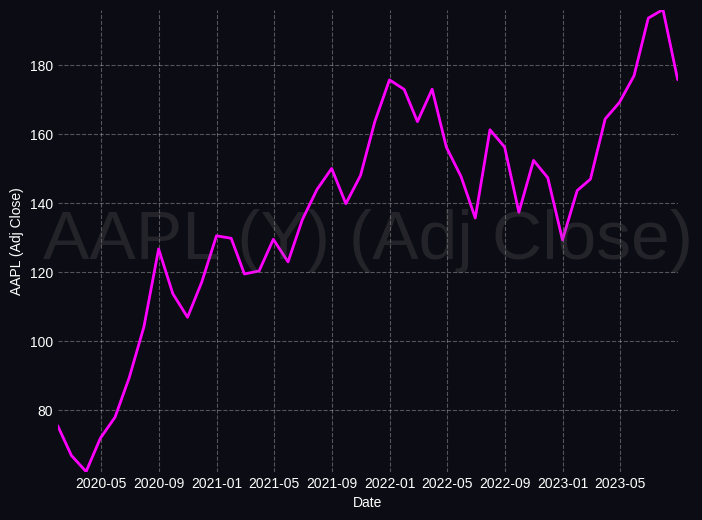

In [12]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np

# Resample the data to monthly frequency
aapl_monthly = aapl.resample('M', on='Date').agg({'Adj Close': 'last'})

# Set up the figure and axes
fig, ax = plt.subplots(figsize=(8, 6))

# Set the background color and style
fig.patch.set_facecolor('#0C0C14')
ax.set_facecolor('#0C0C14')

# Set the x and y limits for the plot
ax.set_xlim(aapl_monthly.index.min(), aapl_monthly.index.max())
ax.set_ylim(aapl_monthly['Adj Close'].min(), aapl_monthly['Adj Close'].max())

# Set the x-axis label
ax.set_xlabel('Date', color='white')

# Set the y-axis label
ax.set_ylabel('AAPL (Adj Close)', color='white')

# Set the tick colors
ax.tick_params(colors='white')

# Set the grid lines
ax.grid(color='white', linestyle='--', alpha=0.3)

# Set the background color and opacity for the title watermark
ax.text(0.5, 0.5, 'AAPL (Y) (Adj Close)', color='gray', fontsize=50, alpha=0.2,
        ha='center', va='center', transform=ax.transAxes)

# Initialize an empty line plot
line, = ax.plot([], [], lw=2, color='#FF00FF')  # Use a Cyberpunk style color for the series line

# Define the update function for the animation
def update(frame):
    # Get the data up to the current frame
    data = aapl_monthly.iloc[:frame + 1]

    # Update the line plot with the new data
    line.set_data(data.index, data['Adj Close'])

    return line,

# Create the animation
ani = animation.FuncAnimation(fig, update, frames=len(aapl_monthly) * 2, interval=100, blit=True)

# Convert the animation to HTML
html_ani = ani.to_jshtml()

# Display the animated chart
from IPython.display import HTML
HTML(html_ani)


Retrieving Stats:

*   **Average Daily Return:** Calculated as the mean of the daily returns.
*   **Maximum Drawdown:** Calculated as the minimum value of the drawdown, which represents the maximum loss from a peak to a subsequent trough in the cumulative returns.
*  **Sharpe Ratio:** A risk-adjusted measure that considers the average daily return and volatility, assuming a risk-free rate of return of 0%.

In [13]:
import numpy as np

# Calculate ROI
start_price = aapl['Adj Close'].iloc[0]
end_price = aapl['Adj Close'].iloc[-1]
roi = (end_price - start_price) / start_price * 100

# Calculate Volatility
daily_returns = aapl['Adj Close'].pct_change()
volatility = daily_returns.std() * np.sqrt(252)  # Assuming 252 trading days in a year

# Calculate Average Daily Return
avg_daily_return = daily_returns.mean()

# Calculate Maximum Drawdown
cumulative_returns = (1 + daily_returns).cumprod()
peak = cumulative_returns.cummax()
drawdown = (cumulative_returns - peak) / peak
max_drawdown = drawdown.min()

# Calculate Sharpe Ratio (assuming risk-free rate of 0%)
risk_free_rate = 0
sharpe_ratio = (avg_daily_return - risk_free_rate) / volatility

# Display the results
print("Investment Analysis:")
print("---------------------")
print(f"ROI: {roi:.2f}%")
print(f"Volatility: {volatility:.2f}")
print(f"Avg Daily Return: {avg_daily_return:.4f}")
print(f"Max Drawdown: {max_drawdown:.2f}")
print(f"Sharpe Ratio: {sharpe_ratio:.2f}")


Investment Analysis:
---------------------
ROI: 140.06%
Volatility: 0.35
Avg Daily Return: 0.0012
Max Drawdown: -0.31
Sharpe Ratio: 0.00


Daily

`    file may be too big to run on colab`

In [14]:
import plotly.graph_objects as go
import plotly.io as pio
from plotly.subplots import make_subplots

# Create subplots with two rows (one for the candlestick chart and one for volume)
fig = make_subplots(rows=2, shared_xaxes=True, row_heights=[0.7, 0.3])

# Add candlestick trace to the first subplot
fig.add_trace(
    go.Candlestick(
        x=aapl['Date'],
        open=aapl['Open'],
        high=aapl['High'],
        low=aapl['Low'],
        close=aapl['Close'],
        name='AAPL'
    ),
    row=1, col=1
)

# Add volume trace to the second subplot
fig.add_trace(
    go.Bar(
        x=aapl['Date'],
        y=aapl['Volume'],
        name='Volume'
    ),
    row=2, col=1
)

# Configure the layout
fig.update_layout(
    title='AAPL Animated Candlestick Chart',
    xaxis_rangeslider_visible=False
)

# Create frames for each data point
frames = []
for i in range(len(aapl)):
    frame = go.Frame(
        data=[go.Candlestick(
            x=aapl['Date'][:i+1],
            open=aapl['Open'][:i+1],
            high=aapl['High'][:i+1],
            low=aapl['Low'][:i+1],
            close=aapl['Close'][:i+1]
        )],
        name=f'frame{i+1}'
    )
    frames.append(frame)

# Add frames to the figure
fig.frames = frames

# Update the animation settings
animation_settings = dict(
    frame=dict(duration=200, redraw=True),
    fromcurrent=True
)
fig.update_layout(updatemenus=[dict(type='buttons', showactive=False, buttons=[dict(label='Play', method='animate', args=[None, animation_settings])])])

# Save the chart as an HTML file
pio.write_html(fig, file='animated_chart.html')

# Download the HTML file
from google.colab import files
files.download('animated_chart.html')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Static chart

/usr/local/lib/python3.10/dist-packages/mplfinance/_arg_validators.py:84: UserWarning:




            POSSIBLE TO SEE DETAILS (Candles, Ohlc-Bars, Etc.)
   For more information see:
   - https://github.com/matplotlib/mplfinance/wiki/Plotting-Too-Much-Data
   
   TO SILENCE THIS WARNING, set `type='line'` in `mpf.plot()`
   OR set kwarg `warn_too_much_data=N` where N is an integer 
   LARGER than the number of data points you want to plot.




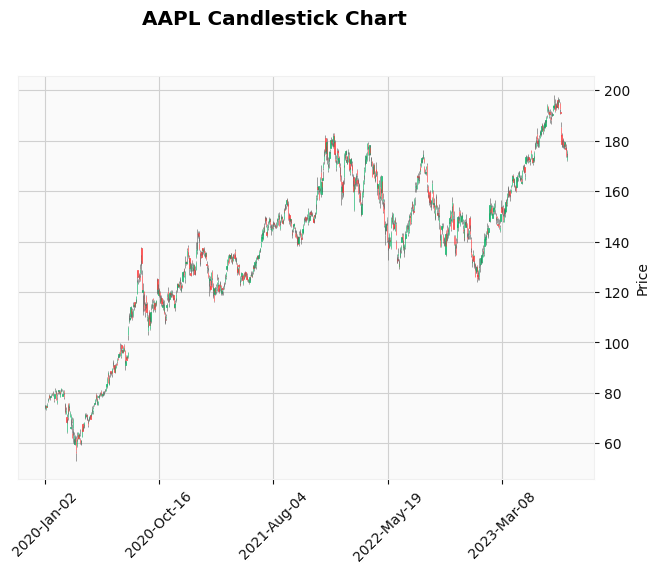

In [15]:
import mplfinance as mpf
import pandas as pd

# Convert the "Date" column to datetime format
aapl['Date'] = pd.to_datetime(aapl['Date'])

# Set the "Date" column as the index
aapl.set_index('Date', inplace=True)

# Plot the candlestick chart
mpf.plot(aapl, type='candle', style='yahoo', title='AAPL Candlestick Chart')
